# Particles

In [1]:
import pyqg
import base64
import numpy as np
from IPython import display
from matplotlib import animation, pyplot as plt

## Initialize and run a model

We'll start it out without particles, so we don't have to update them every timestep while we're just getting out of transience.

In [7]:
m = pyqg.QGModel(nx=256, dt=3600., tmax=5*24*60*60*360.)
m.run()

## Add particles

Now let's add particles. By default, `add_particles()` will add particles in an 8x8 regular grid:

(0.0, 256.0)

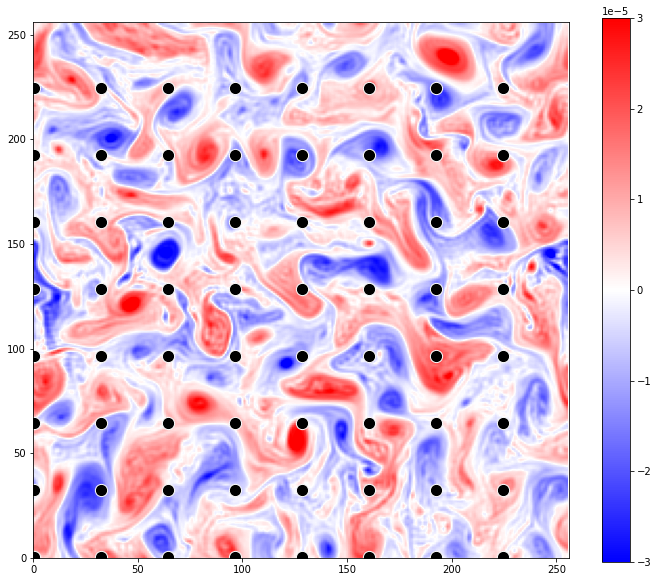

In [37]:
m.add_particles()

parts = m.particles[0]
coords = lambda: np.array([parts.x, parts.y]) * m.nx / m.L

fig = plt.figure(figsize=(12,10))
im = plt.imshow(m.q[0], vmin=-3e-5, vmax=3e-5, cmap='bwr')
sc = plt.scatter(*coords(), color='k', edgecolors='w', s=150)
cb = fig.colorbar(im, ax=plt.gca())
plt.xlim(0,256)
plt.ylim(0,256)

## Step the model forward as part of an animation

The positions of particles initialized in this way update automatically as part of the model's `_step_forward()` routine. Let's use `matplotlib`'s animation API to visualize that:

In [38]:
def animate(i):
    for _ in range(50):
        m._step_forward()
    im.set_data(m.q[0])
    sc.set_offsets(coords().T)
    return [im, sc]
    
anim = animation.FuncAnimation(fig, animate, frames=50, interval=20, blit=True)

MovieWriter imagemagick unavailable; using Pillow instead.



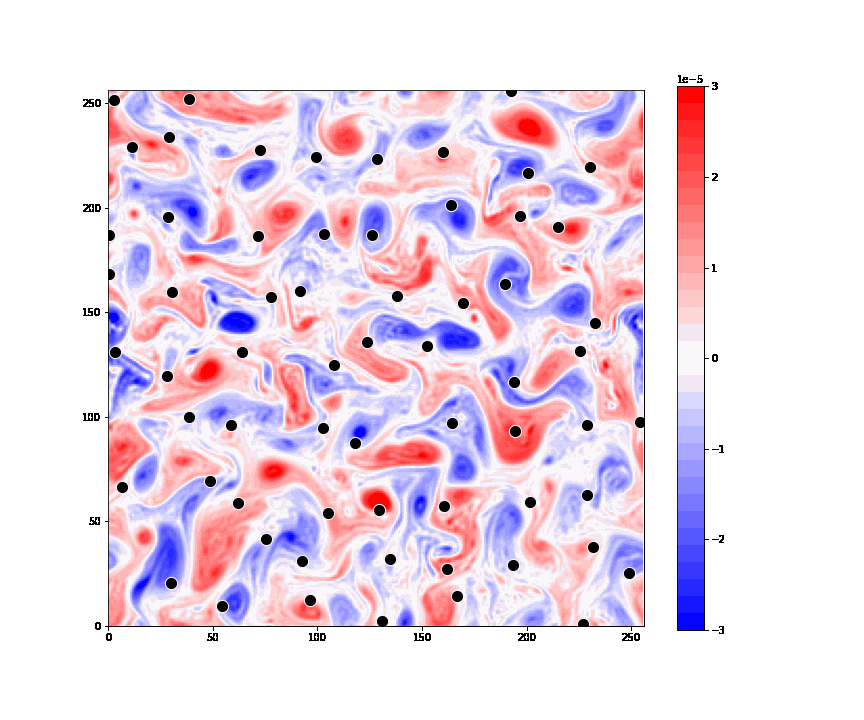

In [39]:
anim.save('particles.gif', writer='imagemagick', fps=60)

# Hack to display gifs in notebooks hosted online
with open('particles.gif', 'rb') as fd:
    b64 = base64.b64encode(fd.read()).decode('ascii')
    
display.HTML(f'<img src="data:image/gif;base64,{b64}" />')

## Initialize particles all in (nearly) the same spot

We can also specify the quantity and initial positions of particles. Let's put them in nearly the same spot and see how they spread: 

In [55]:
m.add_particles(initial_coords=
    np.random.normal(loc=m.L/2, scale=100, size=(2,100)))

parts = m.particles[0]

MovieWriter imagemagick unavailable; using Pillow instead.



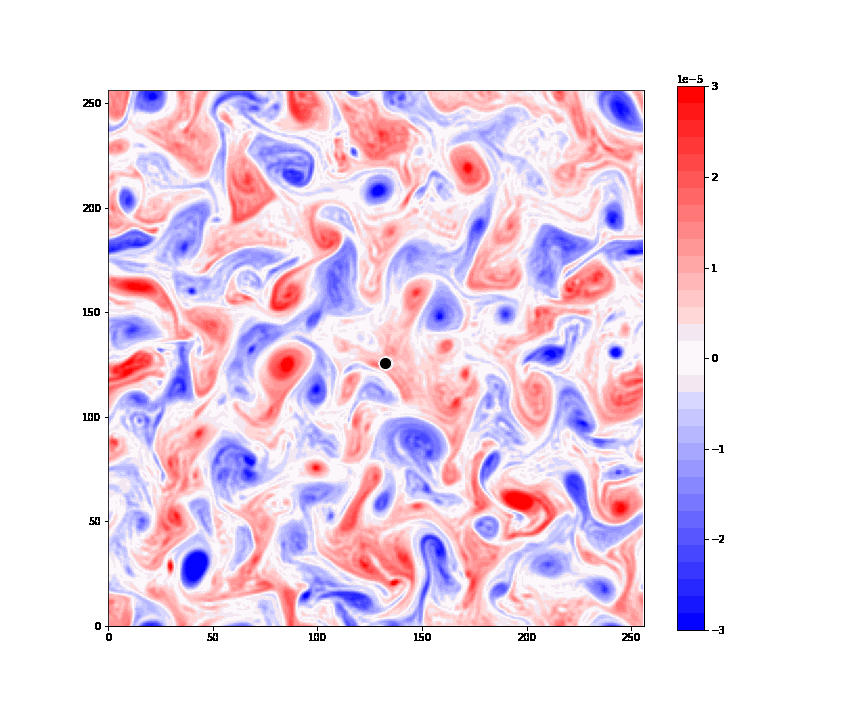

In [56]:
anim = animation.FuncAnimation(fig, animate, frames=200, interval=20, blit=True)

anim.save('particles2.gif', writer='imagemagick', fps=60)

# Hack to display gifs in notebooks hosted online
with open('particles2.gif', 'rb') as fd:
    b64 = base64.b64encode(fd.read()).decode('ascii')
    
display.HTML(f'<img src="data:image/gif;base64,{b64}" />')